In [65]:
#!/bin/env python

import data_describe as dd
import pandas as pd
import itertools
import nltk
from data_describe.text.text_preprocessing import *
from data_describe.misc.load_data import load_data

df = pd.read_csv('vaccination_tweets.csv')

dd.data_summary(df)

,Info
Rows,2518
Columns,16
Size in Memory,280.4 KB


,Data Type,Nulls,Zeros,Min,Median,Max,Mean,Standard Deviation,Unique,Top Frequency
id,int64,0,0,1337727767551553536,1341480911928496128,1347131105703583744,1341948816998208512,2767954103080048.50,2518,1
user_name,object,0,0,,,,,,1704,30
user_location,object,520,0,,,,,,875,520
user_description,object,124,0,,,,,,1613,124
user_created,object,0,0,,,,,,1703,30
user_followers,int64,0,0,0,606,13714928,63429.83,476118.16,1307,31
user_friends,int64,0,0,0,441,64441,1170.95,2468.77,1157,29
user_favourites,int64,0,0,0,1659,924667,13380.42,41697.75,1616,36
user_verified,bool,0,0,,,,,,2,2162
date,object,0,0,,,,,,2516,2


None

data-describe Summary Widget

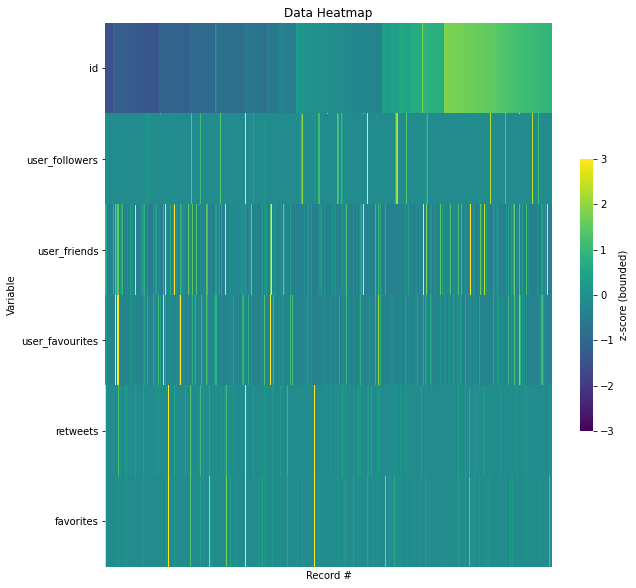

Heatmap Widget showing standardized values.

In [66]:
dd.data_heatmap(df)

data-describe Scatter Plot Widget

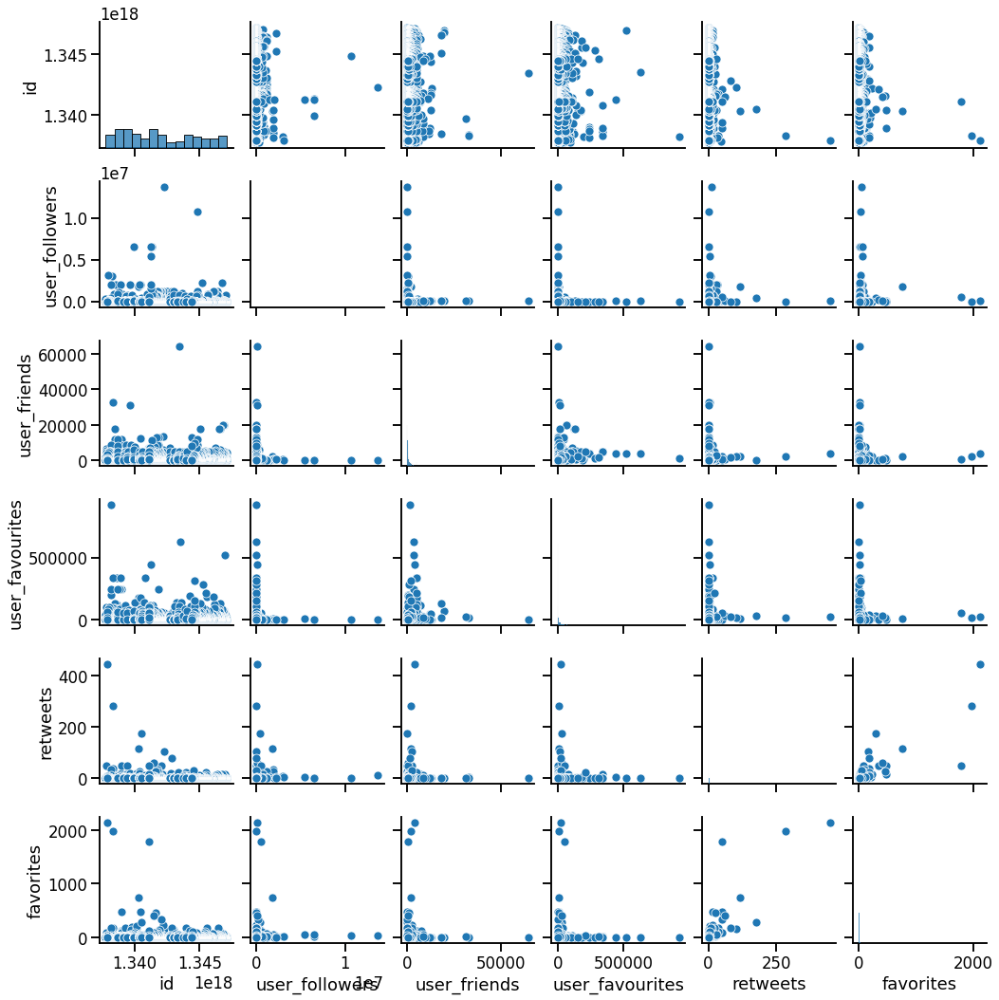

In [78]:
dd.scatter_plots(df, mode = 'matrix')

In [190]:
#tokenize tweets

import nltk

df['tweet_tokens'] = df.apply(lambda row: nltk.word_tokenize(row['text']), axis = 1)
print(df['tweet_tokens'])

0       [Same, folks, said, daikon, paste, could, trea...
1       [While, the, world, has, been, on, the, wrong,...
2       [#, coronavirus, #, SputnikV, #, AstraZeneca, ...
3       [Facts, are, immutable, ,, Senator, ,, even, w...
4       [Explain, to, me, again, why, we, need, a, vac...
                              ...                        
2513    [Very, fortunate, to, have, received, my, firs...
2514    [So, grateful, for, the, 1st, dose, of, the, #...
2515    [#, PfizerBioNTech, #, COVID19, ``, There, is,...
2516    [People, in, NL, tweeting, me, to, say, Dutch,...
2517    [On, #, vaccines, ,, ., @, realDonaldTrump, di...
Name: tweet_tokens, Length: 2518, dtype: object


In [191]:
# to lower case

for i in range(len(df.index)):
    for j in range(len(df['tweet_tokens'][i])):
        df['tweet_tokens'][i][j] = df['tweet_tokens'][i][j].lower()

print(df['tweet_tokens'])
        


0       [same, folks, said, daikon, paste, could, trea...
1       [while, the, world, has, been, on, the, wrong,...
2       [#, coronavirus, #, sputnikv, #, astrazeneca, ...
3       [facts, are, immutable, ,, senator, ,, even, w...
4       [explain, to, me, again, why, we, need, a, vac...
                              ...                        
2513    [very, fortunate, to, have, received, my, firs...
2514    [so, grateful, for, the, 1st, dose, of, the, #...
2515    [#, pfizerbiontech, #, covid19, ``, there, is,...
2516    [people, in, nl, tweeting, me, to, say, dutch,...
2517    [on, #, vaccines, ,, ., @, realdonaldtrump, di...
Name: tweet_tokens, Length: 2518, dtype: object


In [192]:
# remove punctuation/urls
for i in range(len(df.index)):
    for j in range(len(df['tweet_tokens'][i])):
        if not df['tweet_tokens'][i][j].isalpha():
            df['tweet_tokens'][i][j] = 'XFILTEREDX'


print(df['tweet_tokens'])


0       [same, folks, said, daikon, paste, could, trea...
1       [while, the, world, has, been, on, the, wrong,...
2       [XFILTEREDX, coronavirus, XFILTEREDX, sputnikv...
3       [facts, are, immutable, XFILTEREDX, senator, X...
4       [explain, to, me, again, why, we, need, a, vac...
                              ...                        
2513    [very, fortunate, to, have, received, my, firs...
2514    [so, grateful, for, the, XFILTEREDX, dose, of,...
2515    [XFILTEREDX, pfizerbiontech, XFILTEREDX, XFILT...
2516    [people, in, nl, tweeting, me, to, say, dutch,...
2517    [on, XFILTEREDX, vaccines, XFILTEREDX, XFILTER...
Name: tweet_tokens, Length: 2518, dtype: object


In [193]:
#remove stop words

from nltk.corpus import stopwords
stop_words=set(stopwords.words("english"))

for i in range(len(df.index)):
    for j in range(len(df['tweet_tokens'][i])):
        if df['tweet_tokens'][i][j] in stop_words:
            df['tweet_tokens'][i][j] = 'XFILTEREDX'

print(df['tweet_tokens'])

0       [XFILTEREDX, folks, said, daikon, paste, could...
1       [XFILTEREDX, XFILTEREDX, world, XFILTEREDX, XF...
2       [XFILTEREDX, coronavirus, XFILTEREDX, sputnikv...
3       [facts, XFILTEREDX, immutable, XFILTEREDX, sen...
4       [explain, XFILTEREDX, XFILTEREDX, XFILTEREDX, ...
                              ...                        
2513    [XFILTEREDX, fortunate, XFILTEREDX, XFILTEREDX...
2514    [XFILTEREDX, grateful, XFILTEREDX, XFILTEREDX,...
2515    [XFILTEREDX, pfizerbiontech, XFILTEREDX, XFILT...
2516    [people, XFILTEREDX, nl, tweeting, XFILTEREDX,...
2517    [XFILTEREDX, XFILTEREDX, vaccines, XFILTEREDX,...
Name: tweet_tokens, Length: 2518, dtype: object


In [194]:
#get distribution of total words and see how many words have been removed

from nltk.probability import FreqDist

total_text = []

for i in range(len(df.index)):
    for j in range(len(df['tweet_tokens'][i])):
        total_text.append(df['tweet_tokens'][i][j])

fdist = FreqDist(total_text)

fdist.most_common(5)

[('XFILTEREDX', 34394),
 ('https', 2491),
 ('pfizerbiontech', 1173),
 ('vaccine', 1140),
 ('first', 316)]

In [195]:
for z in range(20):
    for i in range(len(df.index)):
        for w in df['tweet_tokens'][i]:
            if w == 'XFILTEREDX' or w == 'https':
                df['tweet_tokens'][i].remove(w)

print(df['tweet_tokens'])

0       [folks, said, daikon, paste, could, treat, cyt...
1       [world, wrong, side, history, year, hopefully,...
2       [coronavirus, sputnikv, astrazeneca, pfizerbio...
3       [facts, immutable, senator, even, ethically, s...
4       [explain, need, vaccine, borisjohnson, matthan...
                              ...                        
2513    [fortunate, received, first, dose, pfizerbiont...
2514    [grateful, dose, pfizerbiontech, vaccine, day,...
2515    [pfizerbiontech, always, light, end, tunnel, way]
2516    [people, nl, tweeting, say, dutch, plan, roll,...
2517    [vaccines, realdonaldtrump, everything, right,...
Name: tweet_tokens, Length: 2518, dtype: object


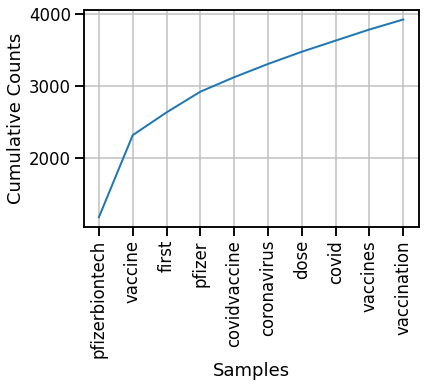

<AxesSubplot:xlabel='Samples', ylabel='Cumulative Counts'>

In [204]:
#check removal

total_text = []

for i in range(len(df.index)):
    for j in range(len(df['tweet_tokens'][i])):
        total_text.append(df['tweet_tokens'][i][j])

fdist = FreqDist(total_text)


fdist.plot(10, cumulative=True)


In [206]:
df.to_csv('tokenized_tweets.csv')